In [24]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from astropy.table import Table
from astropy.table import vstack as tab_vstack

from lvmdap.dap_tools import list_columns,read_DAP_file,map_plot_DAP,scatter
from matplotlib import use as mpl_use
#mpl_use('Agg')

%matplotlib inline
from matplotlib import rcParams as rc
rc.update({'font.size': 19,\
           'font.weight': 900,\
           'text.usetex': True,\
           'path.simplify'           :   True,\
           'xtick.labelsize' : 19,\
           'ytick.labelsize' : 19,\
#           'xtick.major.size' : 3.5,\
#           'ytick.major.size' : 3.5,\
           'axes.linewidth'  : 2.0,\
               # Increase the tick-mark lengths (defaults are 4 and 2)
           'xtick.major.size'        :   6,\
           'ytick.major.size'        :   6,\
           'xtick.minor.size'        :   3,\
           'ytick.minor.size'        :   3,\
           'xtick.major.width'       :   1,\
           'ytick.major.width'       :   1,\
           'lines.markeredgewidth'   :   1,\
           'legend.numpoints'        :   1,\
           'xtick.minor.width'       :   1,\
           'ytick.minor.width'       :   1,\
           'legend.frameon'          :   False,\
           'legend.handletextpad'    :   0.3,\
           'font.family'    :   'serif',\
           'mathtext.fontset'        :   'stix',\
           'axes.facecolor' : "w",\
           
          })
import math
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.colors as mpl_colors
from my_utils import search_col


In [25]:
#DIR_DAP = 'output_atocatl/'
#dap_file = 'dap-rsp108-sn20-00006110.dap.fits.gz'
#dap_file = 'dap-rsp108-sn20-00003735.dap.fits.gz'#dap-rsp108-sn20-00006112.dap.fits.gz'

#DIR_DAP = 'output_sim/'
#dap_file = '00006109_1700_1_1.0.dap.fits.gz'

DIR_DAP = 'output_dap'
dap_file='Helix_DR19.dap.fits.gz'

dap_file=f'{DIR_DAP}/{dap_file}'
tab_DAP=read_DAP_file(dap_file,verbose=True)


---- ALL Table Columns -----
-------------------------------
|        PT                   |
-------------------------------
id        dec       fiberid   
ra        mask      exposure  
----------------------------------
|        RSP                      |
----------------------------------
id             alpha          flux_st        Fe_MW          
MIN_CHISQ      e_alpha        redshift_st    e_Fe_MW        
Teff           Av_st          med_flux_st    alpha_MW       
e_Teff         e_Av_st        e_med_flux_st  e_alpha_MW     
Log_g          z_st           Teff_MW        vel_st         
e_Log_g        e_z_st         e_Teff_MW      log_ML         
Fe             disp_st        Log_g_MW       log_Mass       
e_Fe           e_disp_st      e_Log_g_MW                    
----------------------------------
|        PE_ord                   |
----------------------------------
id                 vel_pe_4340.49     e_disp_pe_6300.3   disp_pe_6716.44    
flux_pe_3726.03    e_vel_pe_4340.49 

In [26]:
tab_DAP

<Table length=1754>
    id            ra         ...   X_sq_pek_9069.0     X_sq_pek_9531.1  
   str9        float64       ...       float64             float64      
--------- ------------------ ... ------------------- -------------------
  4297.10 337.48293835389075 ... 0.22023828537686344  0.4360925906890943
 4297.100  337.4347674360424 ... 0.16317858035228905 0.29165548534537716
4297.1000 337.37382509826847 ...  10.152458988775987   22.30640037295349
4297.1001  337.3641443099038 ...  11.089335127229294   21.41009460637307
4297.1002 337.35446415952134 ...   8.116434000635186   20.05156629425491
4297.1003  337.3447846476107 ...  11.293508226206713   19.44333571916449
4297.1004  337.3353938891206 ...  11.237712168209937  31.286214897333725
4297.1005  337.3450400347244 ...  16.693528402241014   28.38223342636896
4297.1006  337.3547202174644 ...   15.67401301312602   38.38048381681076
4297.1007  337.3644010387494 ...  17.742661608289747   43.02613862165284
      ...                ... ...                 ...                 ...
 4297.990 337.36363095760566 ...   3.775980970700739  11.483487410312938
 4297.991  337.3542081366192 ...   6.753932985257604  18.329996365046103
 4297.992  337.3638876161916 ...   6.180231375894949  16.566513109768792
 4297.993   337.373567733673 ...    8.89220988082403  27.947478219809597
 4297.994  337.3832484885738 ...   5.927972452030457    18.3994552458789
 4297.995 337.39289648052403 ...   9.323383685215232   24.13458887948026
 4297.996 337.40257850774276 ...   11.90911832268781   24.62155313753097
 4297.997  337.4028378831416 ...  12.775092516646763  40.761692260383164
 4297.998  337.3931551848207 ...  10.869564777710886  31.707487503176218
 4297.999 337.38350652412566 ...   10.30739901949922   26.36276606793009

In [27]:
#tab_DAP.add_column(dap_file,name='dap_file')
#tab_DAP['exposure','fiberid','dap_file']

#
# Sky subtraction has a clear issue in the Helix data.
#

#search_col(tab_DAP,'flux_')

search_col(tab_DAP,'6562.85')

flux_Halpha_6562.85
vel_Halpha_6562.85
disp_Halpha_6562.85
EW_Halpha_6562.85
e_flux_Halpha_6562.85
e_vel_Halpha_6562.85
e_disp_Halpha_6562.85
e_EW_Halpha_6562.85
flux_pe_6562.85
e_flux_pe_6562.85
disp_pe_6562.85
e_disp_pe_6562.85
vel_pe_6562.85
e_vel_pe_6562.85
flux_pek_6562.85
e_flux_pek_6562.85
disp_pek_6562.85
e_disp_pek_6562.85
vel_pek_6562.85
e_vel_pek_6562.85
sigma_kms_Halpha_6562.85
sigma_kms_pe_6562.85
sigma_kms_pek_6562.85
X_sq_Halpha_6562.85
X_sq_pe_6562.85
X_sq_pek_6562.85


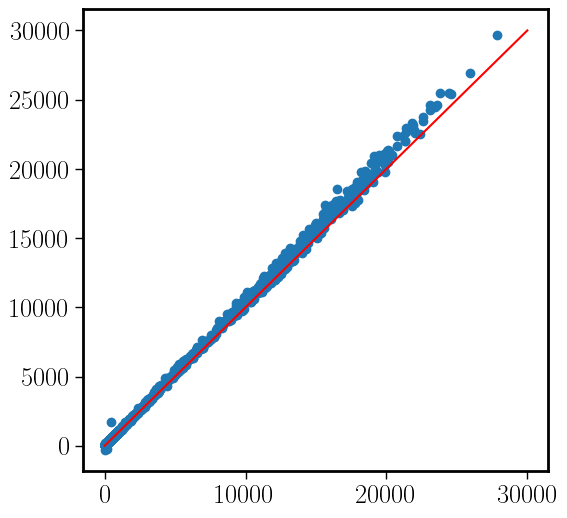

In [28]:
fig,ax = plt.subplots(1,1,figsize=(6,6))
ax.scatter(tab_DAP['flux_pek_6562.85'],tab_DAP['flux_Halpha_6562.85'])
ax.plot([0,30000],[0,30000],color='red')

In [29]:
def map_plot_DAP_rgb(tab_DAP,\
                     rgb_key=('flux_pe_6583.45','flux_pe_6562.85','flux_pe_5006.84'), \
                     rgb_scale=(1.0,1.0,1.0),\
                 vmin=0, vmax=0, titles=('r','g','b'), filename='junk',\
                fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None,fs=18):

    rc.update({'font.size': fs*fsize/5,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : fs*fsize/5,\
               'ytick.labelsize' : fs*fsize/5,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6,\
               'ytick.major.size'        :   6,\
               'xtick.minor.size'        :   3,\
               'ytick.minor.size'        :   3,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X= tab_DAP['ra'].value
    Y= tab_DAP['dec'].value
    R=tab_DAP[rgb_key[2]].value  
    G=tab_DAP[rgb_key[1]].value    
    B=tab_DAP[rgb_key[0]].value 
    R = R * rgb_scale[0]
    G = G * rgb_scale[1]
    B = B * rgb_scale[2]
    RGB = np.stack((R, G, B), axis=1)
    if (vmin==vmax):
        vmin=np.nanmin(RGB)
        vmax=np.nanmax(RGB)
    print(f'min/max:{vmin}/{vmax}')
    r = (R-vmin)/(vmax-vmin)
    g = (G-vmin)/(vmax-vmin)
    b = (B-vmin)/(vmax-vmin)

    r[r>1]=1
    r[r<0]=0
    b[b>1]=1
    b[b<0]=0
    r[r>1]=1
    r[r<0]=0    
    
    r = np.ma.filled(r, fill_value=0.0)
    g = np.ma.filled(g, fill_value=0.0)
    b = np.ma.filled(b, fill_value=0.0)

    r=r**gamma
    g=g**gamma
    b=b**gamma
    
#    print (r)
    r = np.ma.compressed(r)
    g = np.ma.compressed(g)
    b = np.ma.compressed(b)   


    #print(r,g,b)
    colors = np.stack((r, g, b), axis=1)
    colors[colors>1]=1
    colors[colors<0]=0
#    print(colors)
    fig,ax = plt.subplots(1,1,figsize=(fsize,fsize*0.95))
#    norm=mpl_colors.PowerNorm(vmin=0,vmax=1,gamma=gamma)
    scatter(X, Y, ax, color=colors, size=sf*35.6/3600)#, color=colors)
    ax.set_xlabel('Ra [deg]')#,fontsize=21)
    ax.set_ylabel('Dec [deg]')#,fontsize=21)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    ax.set_xlim(xx[1],xx[0])
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.06*(yy[1]-yy[0]),titles[0],fontsize=fs*(fsize/5),color='tomato')
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.12*(yy[1]-yy[0]),titles[1],fontsize=fs*(fsize/5),color='forestgreen')
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.18*(yy[1]-yy[0]),titles[2],fontsize=fs*(fsize/5),color='steelblue')

    if (tab_pt != None):
        for tap_pt_now in tab_pt:
            ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
    try:
        plt.show()
    except:
        plt_show=False
    fig.tight_layout()
    fig.savefig(f'{figs_dir}/{filename}.{fig_type}', facecolor='white')
    plt.close()
    return colors

def search_col(tab,key):
    a_keys=[]
    for keys in tab.columns:
        if (keys.find(key)>-1):
            print(keys)
            a_keys.append(keys)
    return a_keys

In [30]:
search_col(tab_DAP,'[OII]')

flux_[OII]_3726.03
flux_[OII]_3728.82
vel_[OII]_3726.03
vel_[OII]_3728.82
disp_[OII]_3726.03
disp_[OII]_3728.82
EW_[OII]_3726.03
EW_[OII]_3728.82
e_flux_[OII]_3726.03
e_flux_[OII]_3728.82
e_vel_[OII]_3726.03
e_vel_[OII]_3728.82
e_disp_[OII]_3726.03
e_disp_[OII]_3728.82
e_EW_[OII]_3726.03
e_EW_[OII]_3728.82
flux_[OII]_7318.92
flux_[OII]_7329.66
vel_[OII]_7318.92
vel_[OII]_7329.66
disp_[OII]_7318.92
disp_[OII]_7329.66
EW_[OII]_7318.92
EW_[OII]_7329.66
e_flux_[OII]_7318.92
e_flux_[OII]_7329.66
e_vel_[OII]_7318.92
e_vel_[OII]_7329.66
e_disp_[OII]_7318.92
e_disp_[OII]_7329.66
e_EW_[OII]_7318.92
e_EW_[OII]_7329.66
sigma_kms_[OII]_3726.03
sigma_kms_[OII]_3728.82
sigma_kms_[OII]_7318.92
sigma_kms_[OII]_7329.66
X_sq_[OII]_3726.03
X_sq_[OII]_3728.82
X_sq_[OII]_7318.92
X_sq_[OII]_7329.66


['flux_[OII]_3726.03',
 'flux_[OII]_3728.82',
 'vel_[OII]_3726.03',
 'vel_[OII]_3728.82',
 'disp_[OII]_3726.03',
 'disp_[OII]_3728.82',
 'EW_[OII]_3726.03',
 'EW_[OII]_3728.82',
 'e_flux_[OII]_3726.03',
 'e_flux_[OII]_3728.82',
 'e_vel_[OII]_3726.03',
 'e_vel_[OII]_3728.82',
 'e_disp_[OII]_3726.03',
 'e_disp_[OII]_3728.82',
 'e_EW_[OII]_3726.03',
 'e_EW_[OII]_3728.82',
 'flux_[OII]_7318.92',
 'flux_[OII]_7329.66',
 'vel_[OII]_7318.92',
 'vel_[OII]_7329.66',
 'disp_[OII]_7318.92',
 'disp_[OII]_7329.66',
 'EW_[OII]_7318.92',
 'EW_[OII]_7329.66',
 'e_flux_[OII]_7318.92',
 'e_flux_[OII]_7329.66',
 'e_vel_[OII]_7318.92',
 'e_vel_[OII]_7329.66',
 'e_disp_[OII]_7318.92',
 'e_disp_[OII]_7329.66',
 'e_EW_[OII]_7318.92',
 'e_EW_[OII]_7329.66',
 'sigma_kms_[OII]_3726.03',
 'sigma_kms_[OII]_3728.82',
 'sigma_kms_[OII]_7318.92',
 'sigma_kms_[OII]_7329.66',
 'X_sq_[OII]_3726.03',
 'X_sq_[OII]_3728.82',
 'X_sq_[OII]_7318.92',
 'X_sq_[OII]_7329.66']

min/max:-1000/50000.0


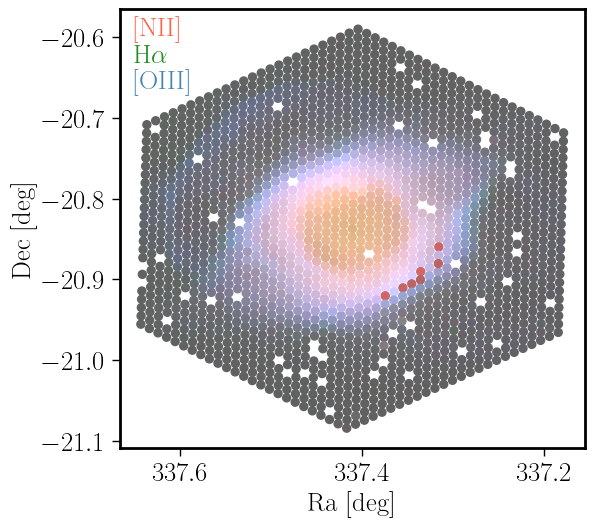

In [31]:
# 637.416/110230.7468
colors=map_plot_DAP_rgb(tab_DAP, \
                 rgb_key=('flux_pe_6583.45','flux_pe_6562.85','flux_pe_5006.84'), \
                 rgb_scale = (1,1,1), \
                 vmin=-1000, vmax=50000.0,\
                 titles=('[NII]',r'H$\alpha$','[OIII]'), filename='Helix',\
                 fsize=6, figs_dir='figs',gamma=0.25,fig_type='png',fs=16)

min/max:-1000/50000.0


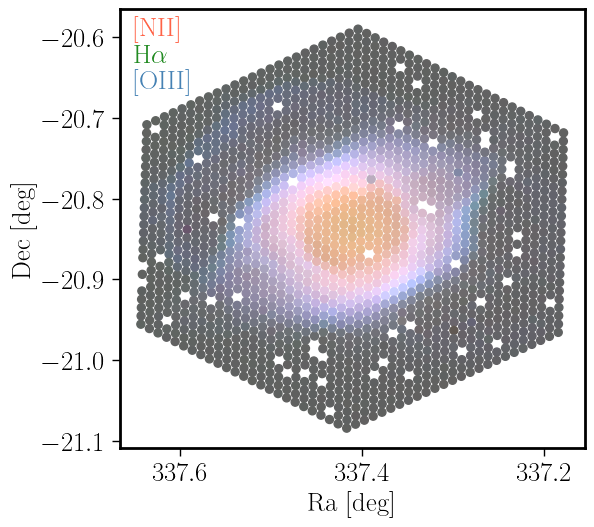

In [32]:
# 637.416/110230.7468
colors=map_plot_DAP_rgb(tab_DAP, \
                 rgb_key=('flux_[NII]_6583.45','flux_Halpha_6562.85','flux_[OIII]_5006.84'), \
                 rgb_scale = (1,1,1), \
                 vmin=-1000, vmax=50000.0,\
                 titles=('[NII]',r'H$\alpha$','[OIII]'), filename='Helix_PN',\
                 fsize=6, figs_dir='figs',gamma=0.25,fig_type='png',fs=16)

min/max:-1000/50000.0


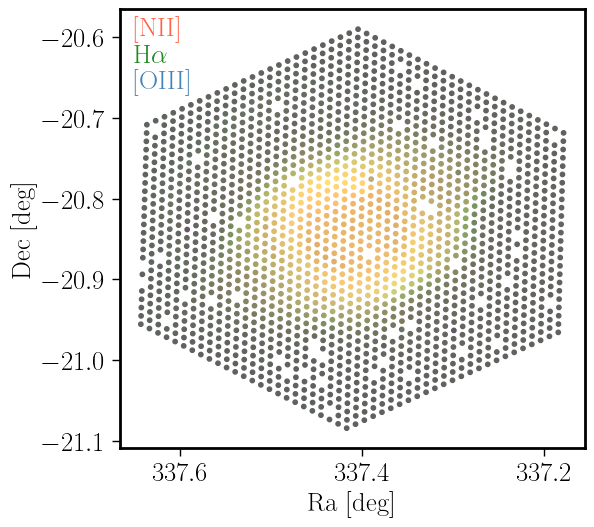

In [33]:
colors_t=map_plot_DAP_rgb(tab_DAP, \
                 rgb_key=('flux_[SIII]_9531.1','flux_Halpha_6562.85','flux_[OIII]_5006.84'), \
                 rgb_scale = (1,1,1), \
                 vmin=-1000, vmax=50000.0,\
                 titles=('[NII]',r'H$\alpha$','[OIII]'), filename='Helix_SIII',\
                 fsize=6, figs_dir='figs',gamma=0.25,fig_type='png',fs=16)

In [11]:
search_col(tab_DAP,'_373')

flux_HI_3734.37
vel_HI_3734.37
disp_HI_3734.37
EW_HI_3734.37
e_flux_HI_3734.37
e_vel_HI_3734.37
e_disp_HI_3734.37
e_EW_HI_3734.37
sigma_kms_HI_3734.37
X_sq_HI_3734.37


['flux_HI_3734.37',
 'vel_HI_3734.37',
 'disp_HI_3734.37',
 'EW_HI_3734.37',
 'e_flux_HI_3734.37',
 'e_vel_HI_3734.37',
 'e_disp_HI_3734.37',
 'e_EW_HI_3734.37',
 'sigma_kms_HI_3734.37',
 'X_sq_HI_3734.37']

In [12]:
search_col(tab_DAP,'flux_')

flux_st
med_flux_st
e_med_flux_st
flux_HI_3686.83
flux_HI_3691.56
flux_HI_3697.15
flux_HI_3703.85
flux_HI_3711.97
flux_[OII]_3726.03
flux_[OII]_3728.82
flux_HI_3734.37
flux_HI_3750.15
flux_[FeVII]_3758.9
flux_HI_3770.63
flux_HI_3797.9
flux_HeI_3819.61
flux_HI_3835.38
flux_[NeIII]_3868.75
flux_HeI_3888.65
flux_HI_3889.05
flux_CaII_3933.66
flux_HeI_3964.73
flux_[NeIII]_3967.46
flux_CaII_3968.47
flux_Hepsilon_3970.07
flux_HeI_4026.19
flux_[SII]_4068.6
flux_[SII]_4076.35
flux_Hdelta_4101.77
flux_HeI_4120.81
flux_[FeII]_4177.21
flux_[FeV]_4227.2
flux_[FeII]_4243.98
flux_CII_4267.0
flux_[FeII]_4287.4
flux_Hgamma_4340.49
flux_[FeII]_4358.1
flux_[FeII]_4358.37
flux_[FeII]_4359.34
flux_[OIII]_4363.21
flux_[FeII]_4413.78
flux_[FeII]_4414.45
flux_[FeII]_4416.27
flux_[FeII]_4452.11
flux_[FeII]_4457.95
flux_[FeII]_4470.29
flux_HeI_4471.48
flux_[FeII]_4474.91
flux_[NiII]_4485.21
flux_[MgI]_4562.48
flux_MgI]_4571.1
flux_[FeII]_4632.27
flux_[FeIII]_4658.1
flux_HeII_4685.68
flux_[FeIII]_4701.62
flux_[A

['flux_st',
 'med_flux_st',
 'e_med_flux_st',
 'flux_HI_3686.83',
 'flux_HI_3691.56',
 'flux_HI_3697.15',
 'flux_HI_3703.85',
 'flux_HI_3711.97',
 'flux_[OII]_3726.03',
 'flux_[OII]_3728.82',
 'flux_HI_3734.37',
 'flux_HI_3750.15',
 'flux_[FeVII]_3758.9',
 'flux_HI_3770.63',
 'flux_HI_3797.9',
 'flux_HeI_3819.61',
 'flux_HI_3835.38',
 'flux_[NeIII]_3868.75',
 'flux_HeI_3888.65',
 'flux_HI_3889.05',
 'flux_CaII_3933.66',
 'flux_HeI_3964.73',
 'flux_[NeIII]_3967.46',
 'flux_CaII_3968.47',
 'flux_Hepsilon_3970.07',
 'flux_HeI_4026.19',
 'flux_[SII]_4068.6',
 'flux_[SII]_4076.35',
 'flux_Hdelta_4101.77',
 'flux_HeI_4120.81',
 'flux_[FeII]_4177.21',
 'flux_[FeV]_4227.2',
 'flux_[FeII]_4243.98',
 'flux_CII_4267.0',
 'flux_[FeII]_4287.4',
 'flux_Hgamma_4340.49',
 'flux_[FeII]_4358.1',
 'flux_[FeII]_4358.37',
 'flux_[FeII]_4359.34',
 'flux_[OIII]_4363.21',
 'flux_[FeII]_4413.78',
 'flux_[FeII]_4414.45',
 'flux_[FeII]_4416.27',
 'flux_[FeII]_4452.11',
 'flux_[FeII]_4457.95',
 'flux_[FeII]_4470.

/tmp/ipykernel_31646/2569418945.py:56: RuntimeWarning: invalid value encountered in log10
  O3=np.log10(OIII)-np.log10(Hb)
/tmp/ipykernel_31646/2569418945.py:57: RuntimeWarning: invalid value encountered in log10
  N2=np.log10(NII)-np.log10(Ha)
/tmp/ipykernel_31646/2569418945.py:58: RuntimeWarning: invalid value encountered in log10
  S2=np.log10(SII/Ha)
/tmp/ipykernel_31646/2569418945.py:59: RuntimeWarning: invalid value encountered in log10
  O1=np.log10(OI/Ha)
/tmp/ipykernel_31646/2569418945.py:60: RuntimeWarning: invalid value encountered in log10
  O2=np.log10(OII)-np.log10(Hb)
/tmp/ipykernel_31646/2569418945.py:61: RuntimeWarning: divide by zero encountered in log10
  lEW_Ha = np.log10(np.abs(tab_DAP['EW_Halpha_6562.85']))
/tmp/ipykernel_31646/2569418945.py:62: RuntimeWarning: divide by zero encountered in divide
  e_lEW_Ha = 0.4*np.abs(tab_DAP['e_EW_Halpha_6562.85']/tab_DAP['EW_Halpha_6562.85'])
/tmp/ipykernel_31646/2569418945.py:84: MatplotlibDeprecationWarning: The get_cmap fu

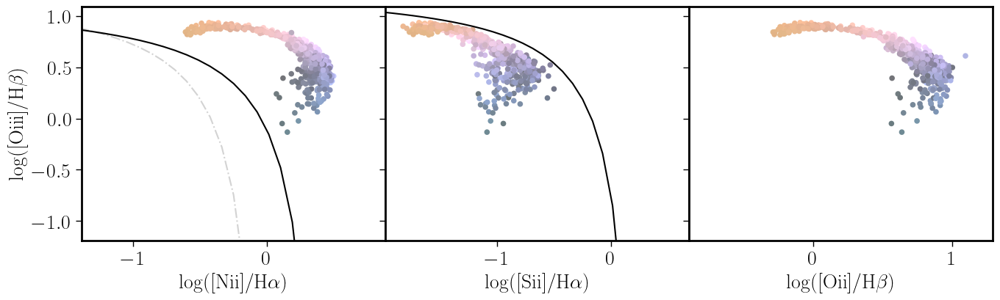

In [13]:
rc.update({'font.size': 20,\
           'font.weight': 900,\
           'text.usetex': True,\
           'path.simplify'           :   True,\
           'xtick.labelsize' : 20,\
           'ytick.labelsize' : 20,\
#           'xtick.major.size' : 3.5,\
#           'ytick.major.size' : 3.5,\
           'axes.linewidth'  : 2.0,\
               # Increase the tick-mark lengths (defaults are 4 and 2)
           'xtick.major.size'        :   6,\
           'ytick.major.size'        :   6,\
           'xtick.minor.size'        :   3,\
           'ytick.minor.size'        :   3,\
           'xtick.major.width'       :   1,\
           'ytick.major.width'       :   1,\
           'lines.markeredgewidth'   :   1,\
           'legend.numpoints'        :   1,\
           'xtick.minor.width'       :   1,\
           'ytick.minor.width'       :   1,\
           'legend.frameon'          :   False,\
           'legend.handletextpad'    :   0.3,\
           'font.family'    :   'serif',\
           'mathtext.fontset'        :   'stix',\
           'axes.facecolor' : "w",\
           
          })


mask_Ha = (tab_DAP['flux_Halpha_6562.85']>100) & (tab_DAP['flux_Halpha_6562.85']>50.0*tab_DAP['e_flux_Halpha_6562.85'])



Ha=tab_DAP['flux_Halpha_6562.85']
Hb=tab_DAP['flux_Hbeta_4861.36']
OIII=tab_DAP['flux_[OIII]_5006.84']
NII=tab_DAP['flux_[NII]_6583.45']
SII=tab_DAP['flux_[SII]_6716.44']+tab_DAP['flux_[SII]_6730.82']
OI=tab_DAP['flux_[OI]_6300.3']
OII=tab_DAP['flux_[OII]_3726.03']+tab_DAP['flux_[OII]_3728.82']
#tab_DAP['flux_pe_3726.03']+tab_DAP['flux_pe_3728.82']

map_dist=np.arange(len(Ha))

eHa=tab_DAP['e_flux_Halpha_6562.85']
eHb=tab_DAP['e_flux_Hbeta_4861.36']
eOIII=tab_DAP['e_flux_[OIII]_5006.84']
eNII=tab_DAP['e_flux_[NII]_6583.45']
eSII=np.sqrt(tab_DAP['e_flux_[SII]_6716.44']**2+tab_DAP['e_flux_[SII]_6730.82']**2)
eOI=tab_DAP['flux_[OI]_6300.3']
eOII=np.sqrt(tab_DAP['e_flux_[OII]_3726.03']**2+tab_DAP['e_flux_[OII]_3728.82']**2)
#tab_DAP['e_flux_pe_3726.03']+tab_DAP['e_flux_pe_3728.82']

#tab_DAP['e_flux_pe_9531.1']

O3=np.log10(OIII)-np.log10(Hb)
N2=np.log10(NII)-np.log10(Ha)
S2=np.log10(SII/Ha)
O1=np.log10(OI/Ha)
O2=np.log10(OII)-np.log10(Hb)
lEW_Ha = np.log10(np.abs(tab_DAP['EW_Halpha_6562.85']))
e_lEW_Ha = 0.4*np.abs(tab_DAP['e_EW_Halpha_6562.85']/tab_DAP['EW_Halpha_6562.85'])
nx = 2.5 #np.max(tab_DAP[mask_Ha]['R_Re'])
#
#
#
fig, axes = plt.subplots(1,3,figsize=(14,4.5), sharey=True, squeeze=False)
x_min1=-1.39
x_max1=0.89
y_min1=-1.29
y_max1=0.99

x=np.linspace(5*x_min1,2*x_max1,100)
cut_y=-0.7+0.2-3.67*x
cut_y2=-1.7+0.5-3.67*x
cut_y3=0.61/(x-0.05)+1.3
cut_y4=0.61/(x-0.47)+1.19
cut_y_SII=0.61/(x-0.3)+1.3;
cut_y_SII=0.61/(x-0.3)+1.3;
cut_y_SII_AGNs=1.89*(x)+0.76;
cut_y_OII=0.73/((x-0.3))+1.33;#+1.10;
cut_y_OII_AGNs=1.18*(x)+0.36;
cut_y_OIII_AGNs=1.14*(x)+0.36;
cm = plt.cm.get_cmap('viridis')
cax1=axes[0,0].scatter(N2[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)
#                       c=map_dist[mask_Ha], marker='o', s=30, alpha=0.35, cmap=cm, vmin=0, vmax=nx)
cax2=axes[0,1].scatter(S2[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)
cax3=axes[0,2].scatter(O2[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)

#axes[0,0].scatter(N2,O3,alpha=0.75, marker='*', s=100,c='green')
#axes[0,1].scatter(S2,O3,alpha=0.75, marker='*', s=100,c='green')
#axes[0,2].scatter(O1,O3,alpha=0.75, marker='*', s=100,c='green')

axes[0,0].plot(x[x<0],cut_y3[x<0],'-.',color='lightgrey')
axes[0,0].plot(x[x<0.5],cut_y4[x<0.5],'-',color='black')
axes[0,1].plot(x[x<0.2],cut_y_SII[x<0.2],'-',color='black')
#axes[0,2].plot(x[x<0.6],cut_y_OII[x<0.6],'-',color='black')


#plt.rcParams.update({'font.size': 16})
axes[0,0].set_ylabel(r'log([Oiii]/H$\beta$)')
axes[0,0].set_xlabel(r'log([Nii]/H$\alpha$)')
axes[0,1].set_xlabel(r'log([Sii]/H$\alpha$)')
axes[0,2].set_xlabel(r'log([Oii]/H$\beta$)')
axes[0,0].set_xlim(x_min1,x_max1)
axes[0,1].set_xlim(x_min1-0.6,x_max1-0.2)
axes[0,2].set_xlim(x_min1+0.5,x_max1+0.4)
axes[0,0].set_ylim(y_min1+0.1,y_max1+0.1)





plt.tight_layout()
plt.subplots_adjust(wspace=0)

fig.savefig(f'figs/BPT_ORION.png', facecolor='white')
plt.show()

#cax1=axes[0,2].scatter(N2[mask_Ha],O3[mask_Ha],c=log_EW_Ha[mask_Ha], marker='o', s=30, alpha=0.35, cmap=cm, vmin=-3, vmax=2.5)
#axes[0,2].plot(x[x<0],cut_y3[x<0],'r-.')
#axes[0,2].plot(x,cut_y4,'b-')
#cb1=add_colorbar(cax1)
#cb1.set_label(r'$log|EW(H\alpha)|$')

/tmp/ipykernel_31646/1270791239.py:54: RuntimeWarning: invalid value encountered in log10
  O3=np.log10(OIII)-np.log10(Hb)
/tmp/ipykernel_31646/1270791239.py:55: RuntimeWarning: invalid value encountered in log10
  N2=np.log10(NII)-np.log10(Ha)
/tmp/ipykernel_31646/1270791239.py:56: RuntimeWarning: invalid value encountered in log10
  S2=np.log10(SII/Ha)
/tmp/ipykernel_31646/1270791239.py:57: RuntimeWarning: invalid value encountered in log10
  O1=np.log10(OI/Ha)
/tmp/ipykernel_31646/1270791239.py:58: RuntimeWarning: divide by zero encountered in log10
  lEW_Ha = np.log10(np.abs(tab_DAP['EW_Halpha_6562.85']))
/tmp/ipykernel_31646/1270791239.py:59: RuntimeWarning: divide by zero encountered in divide
  e_lEW_Ha = 0.4*np.abs(tab_DAP['e_EW_Halpha_6562.85']/tab_DAP['EW_Halpha_6562.85'])
/tmp/ipykernel_31646/1270791239.py:81: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` o

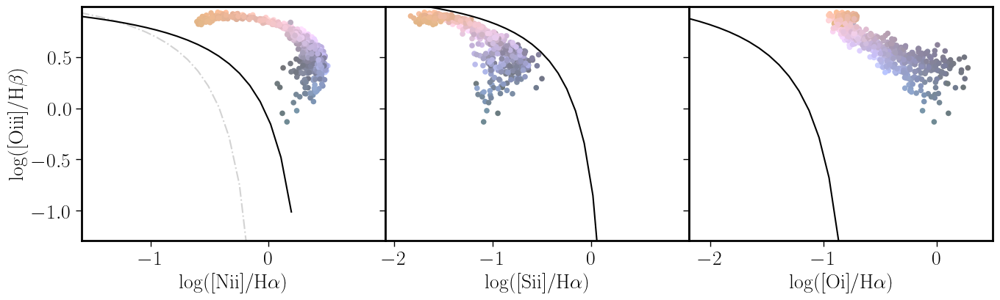

In [14]:
rc.update({'font.size': 20,\
           'font.weight': 900,\
           'text.usetex': True,\
           'path.simplify'           :   True,\
           'xtick.labelsize' : 20,\
           'ytick.labelsize' : 20,\
#           'xtick.major.size' : 3.5,\
#           'ytick.major.size' : 3.5,\
           'axes.linewidth'  : 2.0,\
               # Increase the tick-mark lengths (defaults are 4 and 2)
           'xtick.major.size'        :   6,\
           'ytick.major.size'        :   6,\
           'xtick.minor.size'        :   3,\
           'ytick.minor.size'        :   3,\
           'xtick.major.width'       :   1,\
           'ytick.major.width'       :   1,\
           'lines.markeredgewidth'   :   1,\
           'legend.numpoints'        :   1,\
           'xtick.minor.width'       :   1,\
           'ytick.minor.width'       :   1,\
           'legend.frameon'          :   False,\
           'legend.handletextpad'    :   0.3,\
           'font.family'    :   'serif',\
           'mathtext.fontset'        :   'stix',\
           'axes.facecolor' : "w",\
           
          })


mask_Ha = (tab_DAP['flux_Halpha_6562.85']>100) & (tab_DAP['flux_Halpha_6562.85']>50.0*tab_DAP['e_flux_Halpha_6562.85'])



Ha=tab_DAP['flux_Halpha_6562.85']
Hb=tab_DAP['flux_Hbeta_4861.36']
OIII=tab_DAP['flux_[OIII]_5006.84']
NII=tab_DAP['flux_[NII]_6583.45']
SII=tab_DAP['flux_[SII]_6716.44']+tab_DAP['flux_[SII]_6730.82']
OI=tab_DAP['flux_[OI]_6300.3']
#tab_DAP['flux_pe_3726.03']+tab_DAP['flux_pe_3728.82']

map_dist=np.arange(len(Ha))

eHa=tab_DAP['e_flux_Halpha_6562.85']
eHb=tab_DAP['e_flux_Hbeta_4861.36']
eOIII=tab_DAP['e_flux_[OIII]_5006.84']
eNII=tab_DAP['e_flux_[NII]_6583.45']
eSII=np.sqrt(tab_DAP['e_flux_[SII]_6716.44']**2+tab_DAP['e_flux_[SII]_6730.82']**2)
eOI=tab_DAP['flux_[OI]_6300.3']
#tab_DAP['e_flux_pe_3726.03']+tab_DAP['e_flux_pe_3728.82']

#tab_DAP['e_flux_pe_9531.1']

O3=np.log10(OIII)-np.log10(Hb)
N2=np.log10(NII)-np.log10(Ha)
S2=np.log10(SII/Ha)
O1=np.log10(OI/Ha)
lEW_Ha = np.log10(np.abs(tab_DAP['EW_Halpha_6562.85']))
e_lEW_Ha = 0.4*np.abs(tab_DAP['e_EW_Halpha_6562.85']/tab_DAP['EW_Halpha_6562.85'])
nx = 2.5 #np.max(tab_DAP[mask_Ha]['R_Re'])
#
#
#
fig, axes = plt.subplots(1,3,figsize=(14,4.5), sharey=True, squeeze=False)
x_min1=-1.39
x_max1=0.89
y_min1=-1.29
y_max1=0.99

x=np.linspace(5*x_min1,2*x_max1,100)
cut_y=-0.7+0.2-3.67*x
cut_y2=-1.7+0.5-3.67*x
cut_y3=0.61/(x-0.05)+1.3
cut_y4=0.61/(x-0.47)+1.19
cut_y_SII=0.61/(x-0.3)+1.3;
cut_y_SII=0.61/(x-0.3)+1.3;
cut_y_SII_AGNs=1.89*(x)+0.76;
cut_y_OI=0.73/((x+0.59))+1.33;#+1.10;
cut_y_OI_AGNs=1.18*(x)+1.30;
cut_y_OIII_AGNs=1.14*(x)+0.36;
cm = plt.cm.get_cmap('viridis')
cax1=axes[0,0].scatter(N2[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)
#                       c=map_dist[mask_Ha], marker='o', s=30, alpha=0.35, cmap=cm, vmin=0, vmax=nx)
cax2=axes[0,1].scatter(S2[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)
cax3=axes[0,2].scatter(O1[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)

#axes[0,0].scatter(N2,O3,alpha=0.75, marker='*', s=100,c='green')
#axes[0,1].scatter(S2,O3,alpha=0.75, marker='*', s=100,c='green')
#axes[0,2].scatter(O1,O3,alpha=0.75, marker='*', s=100,c='green')

axes[0,0].plot(x[x<-0.1],cut_y3[x<-0.1],'-.',color='lightgrey')
axes[0,0].plot(x[x<0.2],cut_y4[x<0.2],'-',color='black')
axes[0,1].plot(x[x<0.2],cut_y_SII[x<0.2],'-',color='black')
axes[0,2].plot(x[x<-0.6],cut_y_OI[x<-0.6],'-',color='black')


#plt.rcParams.update({'font.size': 16})
axes[0,0].set_ylabel(r'log([Oiii]/H$\beta$)')
axes[0,0].set_xlabel(r'log([Nii]/H$\alpha$)')
axes[0,1].set_xlabel(r'log([Sii]/H$\alpha$)')
axes[0,2].set_xlabel(r'log([Oi]/H$\alpha$)')
axes[0,0].set_xlim(x_min1-0.2,x_max1+0.1)
axes[0,1].set_xlim(x_min1-0.7,x_max1+0.1)
axes[0,2].set_xlim(x_min1-0.8,x_max1-0.4)
axes[0,0].set_ylim(y_min1,y_max1)





plt.tight_layout()
plt.subplots_adjust(wspace=0)

fig.savefig(f'figs/BPT_HELIX_OI.png', facecolor='white')
plt.show()

#cax1=axes[0,2].scatter(N2[mask_Ha],O3[mask_Ha],c=log_EW_Ha[mask_Ha], marker='o', s=30, alpha=0.35, cmap=cm, vmin=-3, vmax=2.5)
#axes[0,2].plot(x[x<0],cut_y3[x<0],'r-.')
#axes[0,2].plot(x,cut_y4,'b-')
#cb1=add_colorbar(cax1)
#cb1.set_label(r'$log|EW(H\alpha)|$')

In [15]:
#
# Lines with enough S/N
#
#tab_sum_flux=Table()
name_cols=[]
w_sum = []
sum_flux=[]
e_sum_flux=[]


col_flux=search_col(tab_DAP,'flux_')
print ('------------------------------------\n')
#col_flux_np=[]
for cols in col_flux:
#    print (cols,cols.find('e_'))
    if ((cols.find('e_')==-1) and (cols.find('pe_')==-1) and (cols.find('st')==-1)  and (cols.find('pek_')==-1) ):
        a_cols=cols.split('_') 
        w_now=a_cols[-1]
        e_cols='e_'+cols
        name_cols.append(cols)
        w_sum.append(float(w_now))
        sum_flux_now=np.nansum(tab_DAP[cols])
        e_sum_flux_now=np.sqrt(np.nansum((tab_DAP[e_cols]**2)))
        sum_flux.append(sum_flux_now)
        e_sum_flux.append(e_sum_flux_now)

name_cols=np.array(name_cols)
sum_flux=np.array(sum_flux)
e_sum_flux=np.array(e_sum_flux)
tab_sum_flux=Table((name_cols,w_sum,sum_flux,e_sum_flux),names=('eline','wave','flux','e_flux'))


flux_st
med_flux_st
e_med_flux_st
flux_HI_3686.83
flux_HI_3691.56
flux_HI_3697.15
flux_HI_3703.85
flux_HI_3711.97
flux_[OII]_3726.03
flux_[OII]_3728.82
flux_HI_3734.37
flux_HI_3750.15
flux_[FeVII]_3758.9
flux_HI_3770.63
flux_HI_3797.9
flux_HeI_3819.61
flux_HI_3835.38
flux_[NeIII]_3868.75
flux_HeI_3888.65
flux_HI_3889.05
flux_CaII_3933.66
flux_HeI_3964.73
flux_[NeIII]_3967.46
flux_CaII_3968.47
flux_Hepsilon_3970.07
flux_HeI_4026.19
flux_[SII]_4068.6
flux_[SII]_4076.35
flux_Hdelta_4101.77
flux_HeI_4120.81
flux_[FeII]_4177.21
flux_[FeV]_4227.2
flux_[FeII]_4243.98
flux_CII_4267.0
flux_[FeII]_4287.4
flux_Hgamma_4340.49
flux_[FeII]_4358.1
flux_[FeII]_4358.37
flux_[FeII]_4359.34
flux_[OIII]_4363.21
flux_[FeII]_4413.78
flux_[FeII]_4414.45
flux_[FeII]_4416.27
flux_[FeII]_4452.11
flux_[FeII]_4457.95
flux_[FeII]_4470.29
flux_HeI_4471.48
flux_[FeII]_4474.91
flux_[NiII]_4485.21
flux_[MgI]_4562.48
flux_MgI]_4571.1
flux_[FeII]_4632.27
flux_[FeIII]_4658.1
flux_HeII_4685.68
flux_[FeIII]_4701.62
flux_[A

30


eline,wave,flux,e_flux,SN
str21,float64,float64,float64,float64
flux_[OIII]_5006.84,5006.84,11812249.623012114,25565.83704765133,462.0325789058128
flux_[NII]_6583.45,6583.45,11206925.646606436,22863.665091251638,490.16313009651986
flux_Halpha_6562.85,6562.85,6597670.65949375,2668.925392739731,2472.0326306015795
flux_[OII]_3728.82,3728.82,6087651.787797162,4444.0541401213795,1369.8419496822087
flux_[OII]_3726.03,3726.03,4702727.6686963495,4709.184504355647,998.6288845439534
flux_[OI]_6300.3,6300.3,3786981.246004815,3090.2701869166563,1225.4531212312243
flux_[NII]_6548.05,6548.05,3716372.6441772715,68420.17146025701,54.31691509770606
flux_[OIII]_4958.91,4958.91,3687347.605501587,83712.19660213147,44.04791362753107
flux_Hbeta_4861.36,4861.36,2377850.530675144,7676.073290960298,309.7743391110415


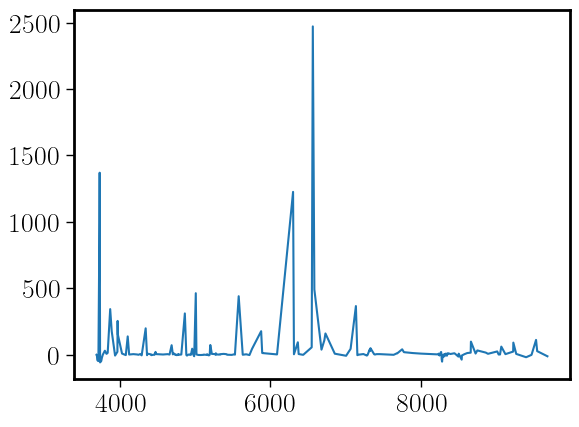

In [16]:
#tab_sum_flux
SN = tab_sum_flux['flux']/tab_sum_flux['e_flux']
try:
    tab_sum_flux.add_column(SN,name='SN')
except:
    print('SN not needed')
plt.plot(tab_sum_flux['wave'],SN)
tab_sum_good = tab_sum_flux[SN>45]
print(len(tab_sum_good))

tab_sum_flux.sort('flux',reverse=True)

#search_col(tab_DAP,'Halpha')
#SN_Ha=SN[tab_sum_flux['wave']==6562.85]

tab_sum_flux[0:36]

In [17]:
def map_plot_DAP(tab_DAP,line='flux_Halpha_6562.85', \
                 vmin=0, vmax=0, title=None, filename='junk',\
                 cmap='Spectral', fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None):

    rc.update({'font.size': 19,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : 19,\
               'ytick.labelsize' : 19,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6,\
               'ytick.major.size'        :   6,\
               'xtick.minor.size'        :   3,\
               'ytick.minor.size'        :   3,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X=tab_DAP['ra']
    Y=tab_DAP['dec']
    C=tab_DAP[line]    
    if (title== None):
        title=line.replace("_"," ")
        title=line.replace("_"," ")
    if (vmin==vmax):
        vmin=0.00001*np.nanmax(C)
        vmax=np.nanmax(C)
    print(line,vmin,vmax)
    fig,ax = plt.subplots(1,1,figsize=(fsize,fsize/1.3))
    norm=mpl_colors.PowerNorm(vmin=vmin,vmax=vmax,gamma=gamma)
    scat=scatter(X, Y, ax, size=sf*35.6/3600, c=C, cmap=cmap, norm=norm)
#    scat=scatter(X, Y, ax, size=35.6/3600, c=C,vmin = vmin, vmax = vmax, cmap=cmap, norm=colors.PowerNorm(gamma=gamma))
    ax.set_xlabel('Ra [deg]')#,fontsize=21)
    ax.set_ylabel('Dec [deg]')#,fontsize=21)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    ax.set_xlim(xx[1],xx[0])
    props = dict(boxstyle='square', facecolor='white', alpha=0.5)
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.08*(yy[1]-yy[0]),title,color='black',\
            bbox=props)
    ax.text(xx[1]-0.52*(xx[1]-xx[0]),yy[0]+0.06*(yy[1]-yy[0]),r'10$^{-16}$ erg/s/cm$^2$',color='black',\
            bbox=props)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(scat.sc, cax=cax, format='%.0e')#,label=fr'{title}')#,fontsize=21)
    if (tab_pt != None):
        for tap_pt_now in tab_pt:
            ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
    try:
        plt.show()
    except:
        plt_show=False
    fig.tight_layout()
    fig.savefig(f'{figs_dir}/{filename}.{fig_type}')
    plt.close()


In [18]:
def map_plot_DAP_ax(tab_DAP,ax=None,fig=None,line='flux_Halpha_6562.85', \
                 vmin=0, vmax=0, title=None, filename='junk',\
                 cmap='Spectral', fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None,xlab=True,ylab=True, fs=1.0,f_scale=1e7):

    rc.update({'font.size': 19*fs,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : 19*fs,\
               'ytick.labelsize' : 19*fs,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6*fs,\
               'ytick.major.size'        :   6*fs,\
               'xtick.minor.size'        :   3*fs,\
               'ytick.minor.size'        :   3*fs,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X=tab_DAP['ra']
    Y=tab_DAP['dec']
    C=tab_DAP[line]/f_scale    
    if (title== None):
        title=line.replace("_"," ")
        title=line.replace("_"," ")
    if (vmin==vmax):
        vmin=0.00001*np.nanmax(C)
        vmax=np.nanmax(C)
#    print(line,vmin,vmax)
    #fig,ax = plt.subplots(1,1,figsize=(fsize,fsize/1.3))
    norm=mpl_colors.PowerNorm(vmin=vmin,vmax=vmax,gamma=gamma)
    size_sc = sf*35.6/3600
#    print(size_sc)
    scat=ax.scatter(X, Y, s=10*sf, c=C, cmap=cmap, norm=norm, rasterized=True)
#    scat=scatter(X, Y, ax=ax, size=sf*35.6/3600, c=C, cmap=cmap, norm=norm, rasterized=True)
#    scat=scatter(X, Y, ax, size=35.6/3600, c=C,vmin = vmin, vmax = vmax, cmap=cmap, norm=colors.PowerNorm(gamma=gamma))
    if (xlab == True):
        ax.set_xlabel('Ra [deg]',fontsize=19*fs)
    if (ylab == True):
        ax.set_ylabel('Dec [deg]',fontsize=19*fs)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    ax.set_xlim(xx[1],xx[0])
    props = dict(boxstyle='square', facecolor='white', alpha=0.5)
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.08*fs*(yy[1]-yy[0]),rf'{title}',color='black',\
            bbox=props)
#    ax.text(xx[1]-0.52*(xx[1]-xx[0]),yy[0]+0.06*(yy[1]-yy[0]),r'10$^{-16}$ erg/s/cm$^2$',color='black',\
#            bbox=props)
    return scat
    #divider = make_axes_locatable(ax)
    #cax = divider.append_axes("right", size="5%", pad=0.05)
    #plt.colorbar(scat, cax=cax, format='%.0e')#,label=fr'{title}')#,fontsize=21)
    #if (tab_pt != None):
    #    for tap_pt_now in tab_pt:
    #        ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
#    try:
#        plt.show()
#    except:
#        plt_show=False
#    fig.tight_layout()
#    fig.savefig(f'{figs_dir}/{filename}.{fig_type}')
#    plt.close()


Sky median [OI] 6300.3: 1914.61665
Sky median [NII] 6548.05: 311.54925000000003


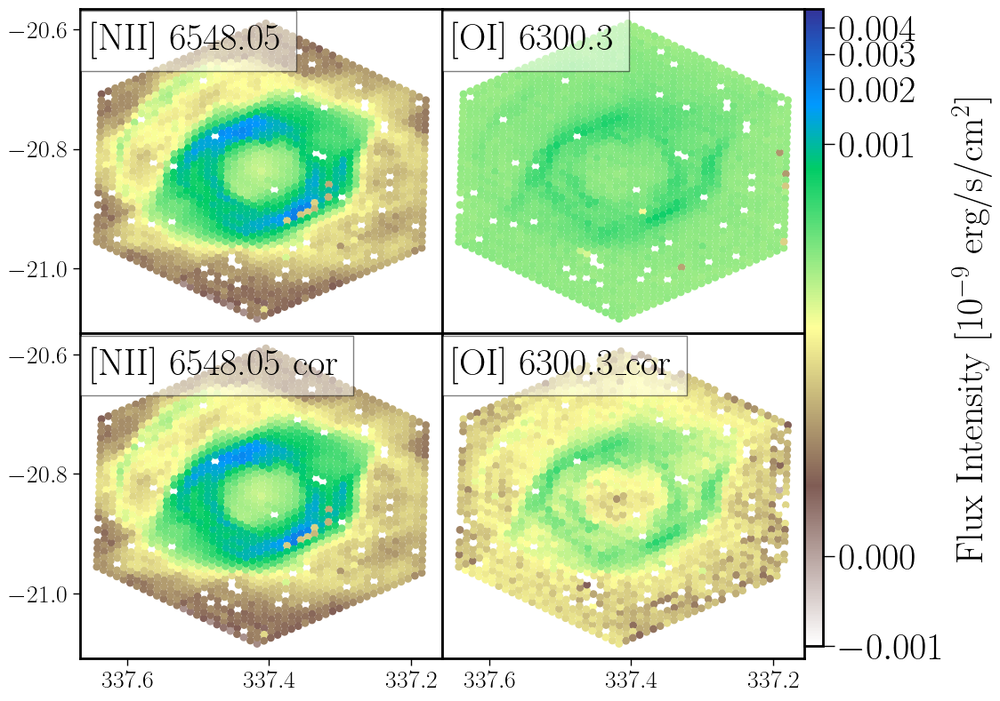

In [19]:
#f_scale = 1
filename = 'figs/junk_Helix'
#cmap='gnuplot2_r'
gamma=0.15
#cmap='pink_r'
#cmap='Spectral'
#cmap='nipy_spectral_r'
#cmap='cubehelix_r'
cmap='terrain_r'
#cmap='gist_earth_r'
#fig = plt.figure()
NX=4
NY=5
fs=1.6
f_scale=1e7
xlab = ''
ylab = ''
fig,axes = plt.subplots(2,2,figsize=(10.5,9.5))
vmin=0
vmax=0.49e5
axs = axes

ax = axes[0,0]
eline='flux_pe_6548.05'
title='[NII] 6548.05'
scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                 vmin=-0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
ax.set_xticks([])

ax = axes[0,1]
eline='flux_pe_6300.3'
title='[OI] 6300.3'
scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                 vmin=-0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
ax.set_xticks([])
ax.set_yticks([])


mask_sky = (tab_DAP['dec']<-20.5) | (tab_DAP['dec']>-21.2)

med_sky_OI = np.median(tab_DAP['flux_pe_6300.3'][mask_sky])
med_sky_NII = np.median(tab_DAP['flux_pe_6548.05'][mask_sky])

std_sky_OI = np.std(tab_DAP['flux_pe_6300.3'][mask_sky])
std_sky_NII = np.std(tab_DAP['flux_pe_6548.05'][mask_sky])

if (med_sky_OI>2*std_sky_OI):
    sky_cor_OI = med_sky_OI-0.5*std_sky_OI
else:
    sky_cor_OI = 0.0

if (med_sky_NII>2*std_sky_NII):
    sky_cor_NII = med_sky_NII-0.5*std_sky_NII
else:
    sky_cor_NII = 0.0

print(f'Sky median [OI] 6300.3: {med_sky_OI}')
print(f'Sky median [NII] 6548.05: {med_sky_NII}')

tab_DAP['flux_pe_6300.3_cor'] = tab_DAP['flux_pe_6300.3']-sky_cor_OI
tab_DAP['flux_pe_6548.05_cor'] = tab_DAP['flux_pe_6548.05']-sky_cor_NII

ax = axes[1,0]
eline='flux_pe_6548.05_cor'
title='[NII] 6548.05 cor'
scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                 vmin=-0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
#ax.set_xticks([])

ax = axes[1,1]
eline='flux_pe_6300.3_cor'
title='[OI] 6300.3_cor'
scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                 vmin=-0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
#ax.set_xticks([])
ax.set_yticks([])

xx = ax.get_xlim()
yy = ax.get_ylim()



cax = fig.add_axes([0.9, 0.125, 0.02, 0.755])  # Ajusta estos valores según necesites
cbar = fig.colorbar(scat, cax=cax, ax=axs.ravel().tolist(), orientation='vertical')#, format='%.0e')
cbar.set_label('Flux Intensity [10$^{-9}$ erg/s/cm$^2$]')
#ax.set_yticks([])



plt.subplots_adjust(wspace=0,hspace=0)
plt.show()    
#fig.tight_layout(w_pad=0.2)
fig.savefig(f'figs/Helix_felines_cor.pdf', facecolor='white')

In [20]:
tab_DAP['ra','dec']

ra,dec
float64,float64
337.48293835389075,-21.0468158671032
337.4347674360424,-21.032434874759847
337.37382509826847,-20.889530433814635
337.3641443099038,-20.884589791490775
337.35446415952134,-20.879648604893337
337.3447846476107,-20.874706874519163
337.3353938891206,-20.880061470276523
337.3450400347244,-20.88500445143705
337.3547202174644,-20.88994616766101


Sky median [OIII]5006.84: 426.4201316862094 +/- 12779.44696670113  
Sky median [NII]6583.45: 945.0231682505464 +/- 11041.119962875928  
Sky median H$\alpha$6562.85: 522.6525683947486 +/- 5945.8862230016775  
Sky median [OII]3728.82: 645.0436557849855 +/- 5803.543141399106  
Sky median [OII]3726.03: 518.5958349336762 +/- 4532.811517979332  
Sky median [OI]6300.3: 1884.911865489329 +/- 717.9133847565557  ***
Sky median [NII]6548.05: 302.8096727705332 +/- 3677.7940827971042  
Sky median [OIII]4958.91: 112.59400387435491 +/- 4017.455202765135  
Sky median H$\beta$4861.36: 196.83795225737887 +/- 2149.4462055242425  
Sky median [NeIII]3868.75: 147.82875606585037 +/- 1955.4020905143368  
Sky median [OI]5577.34: 913.9152555069911 +/- 120.34973256706496  ***
Sky median [OI]6363.78: 652.9604201611407 +/- 241.14160392973073  ***
Sky median H$\gamma$4340.49: 98.0932506519595 +/- 968.082198294597  
Sky median [NeIII]3967.46: 63.843132445616845 +/- 701.0615282865836  
Sky median H$\delta$4101.77: 81

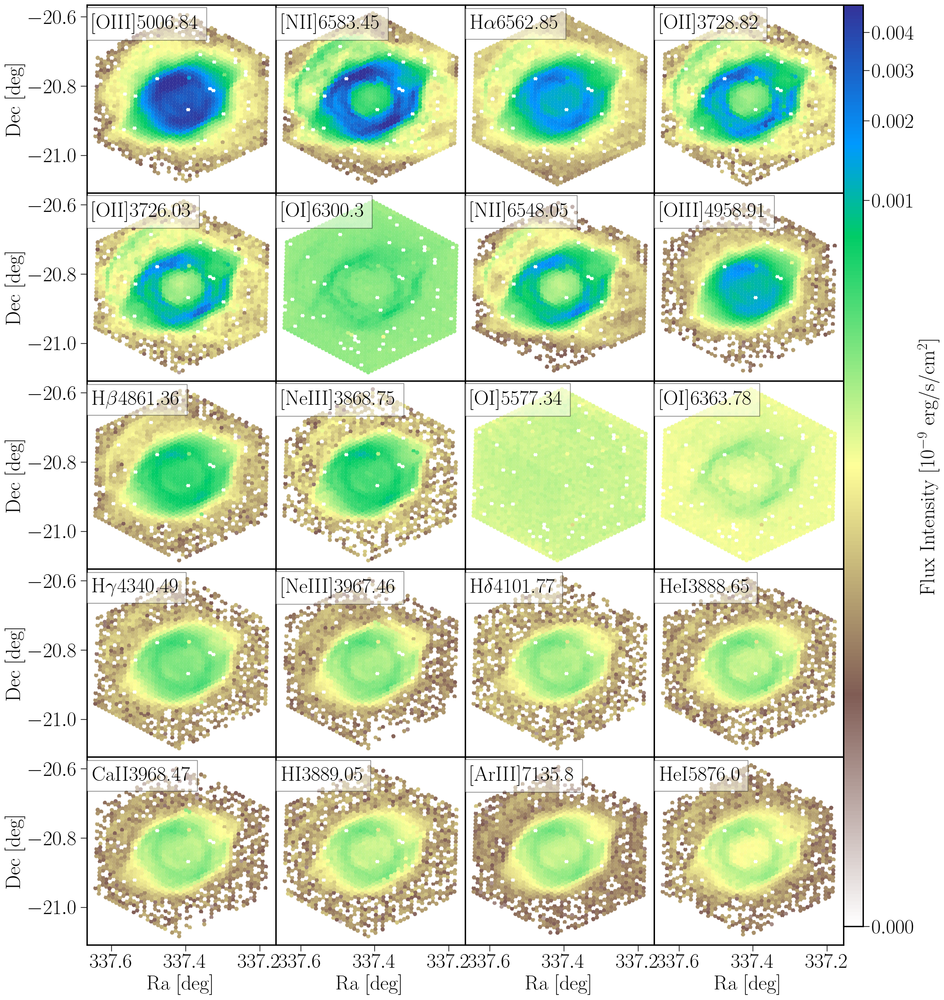

In [ ]:
#cmap='gnuplot2_r'
gamma=0.15
#cmap='pink_r'
#cmap='Spectral'
#cmap='nipy_spectral_r'
#cmap='cubehelix_r'
cmap='terrain_r'
#cmap='gist_earth_r'
#fig = plt.figure()
NX=4
NY=5
fs=1.6
f_scale=1e7
fig, axs = plt.subplots(nrows=NY, ncols=NX, figsize=(5*NX, 5*NY))#/1.3))


#axs_flat = axs.flatten
for I,ax in enumerate(np.ravel(axs)):
    #print(ax)
    tab_now=tab_sum_flux[I]
    eline=tab_now['eline']
    wave=np.ceil(tab_now['wave'])
    II=str(I)
    if (I<10):
        II='0'+str(I)
    filename=f'Helix_{II}_{wave}'
    title=eline.replace('flux_','')
    title=title.replace('_','')
    title=title.replace('flux','')
    title=title.replace('alpha','$\\alpha$')
    title=title.replace('beta','$\\beta$')
    title=title.replace('gamma','$\\gamma$')    
    title=title.replace('delta','$\\delta$')
    title=title.replace('epsilon','$\\epsilon$')    
    xlab = False
    ylab = False
    if ((I/NX)==int(I/NX)):
        ylab=True
    else:
        ax.set_yticks([])
    if (I>=(NX*NY-4)):
        xlab=True
    else:
        ax.set_xticks([])
    vmin=0
    vmax=0.49e5
#    vmax=8e5
    mask_sky = (tab_DAP['dec']<-20.5) | (tab_DAP['dec']>-21.2)

    med_sky = np.median(tab_DAP[eline][mask_sky])
    std_sky = np.std(tab_DAP[eline][mask_sky])
    if (med_sky>2*std_sky):
        label = '***'
    else:
        label = ''
    print(f'Sky median {title}: {med_sky} +/- {std_sky}  {label}')

    scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                 vmin=0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    #print(xx,yy)
    
#divider = make_axes_locatable(ax)
#cax = divider.append_axes("right", size="5%", pad=0.05)    
cax = fig.add_axes([0.9, 0.125, 0.02, 0.755])  # Ajusta estos valores según necesites
cbar = fig.colorbar(scat, cax=cax, ax=axs.ravel().tolist(), orientation='vertical')#, format='%.0e')
cbar.set_label('Flux Intensity [10$^{-9}$ erg/s/cm$^2$]')

plt.subplots_adjust(wspace=0,hspace=0)
plt.show()    
#fig.tight_layout(w_pad=0.2)
fig.savefig(f'figs/Helix_felines.pdf', facecolor='white')

#if (I>3):
    #    break

In [22]:
plt.show()

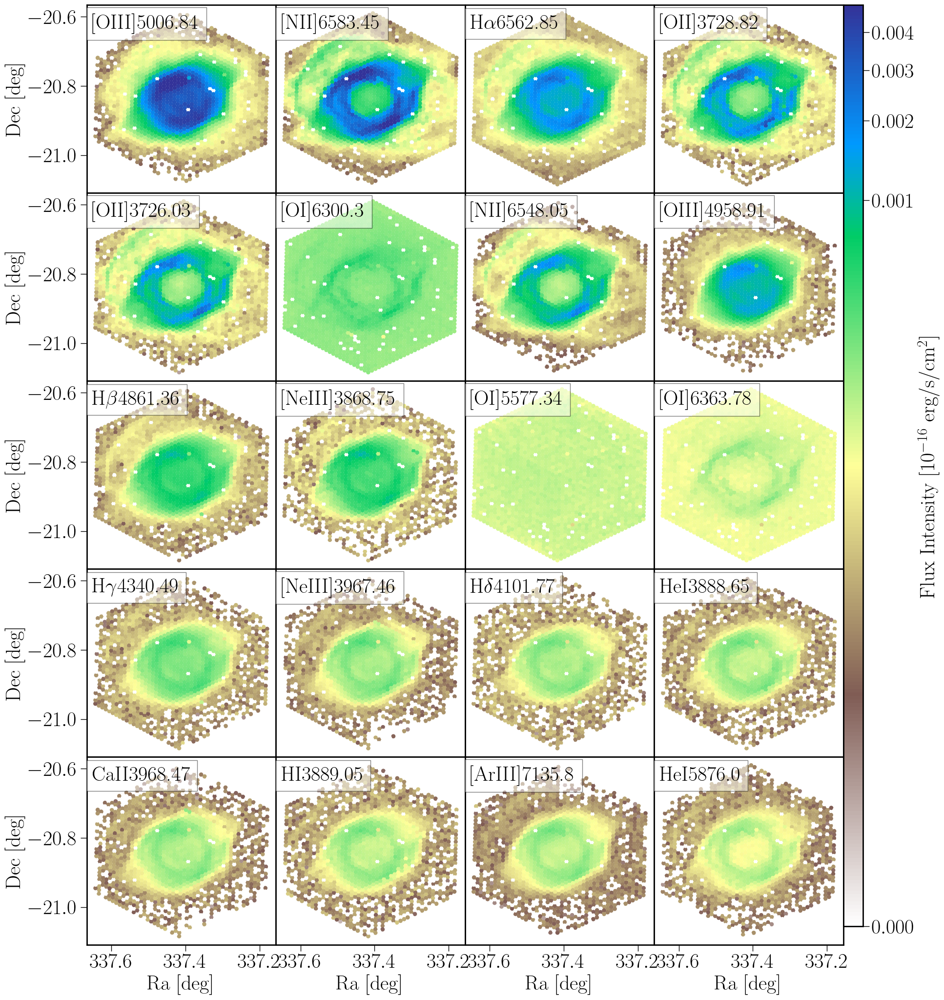

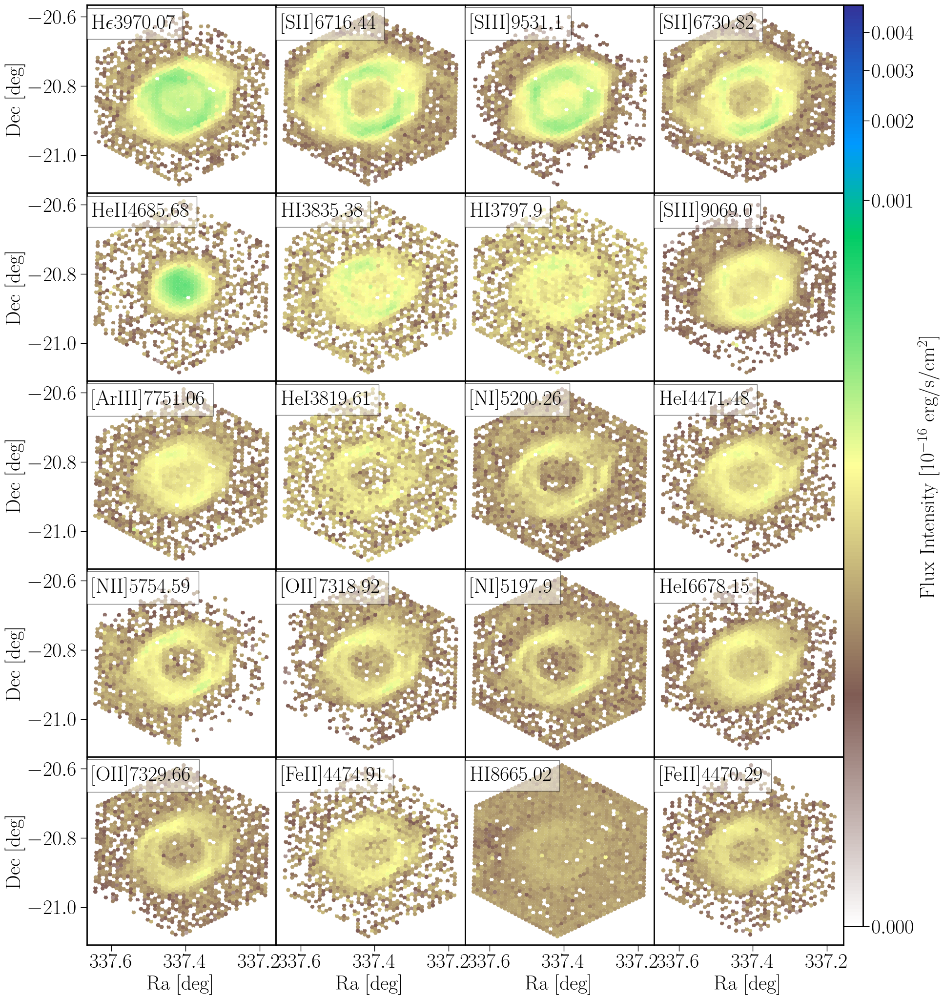

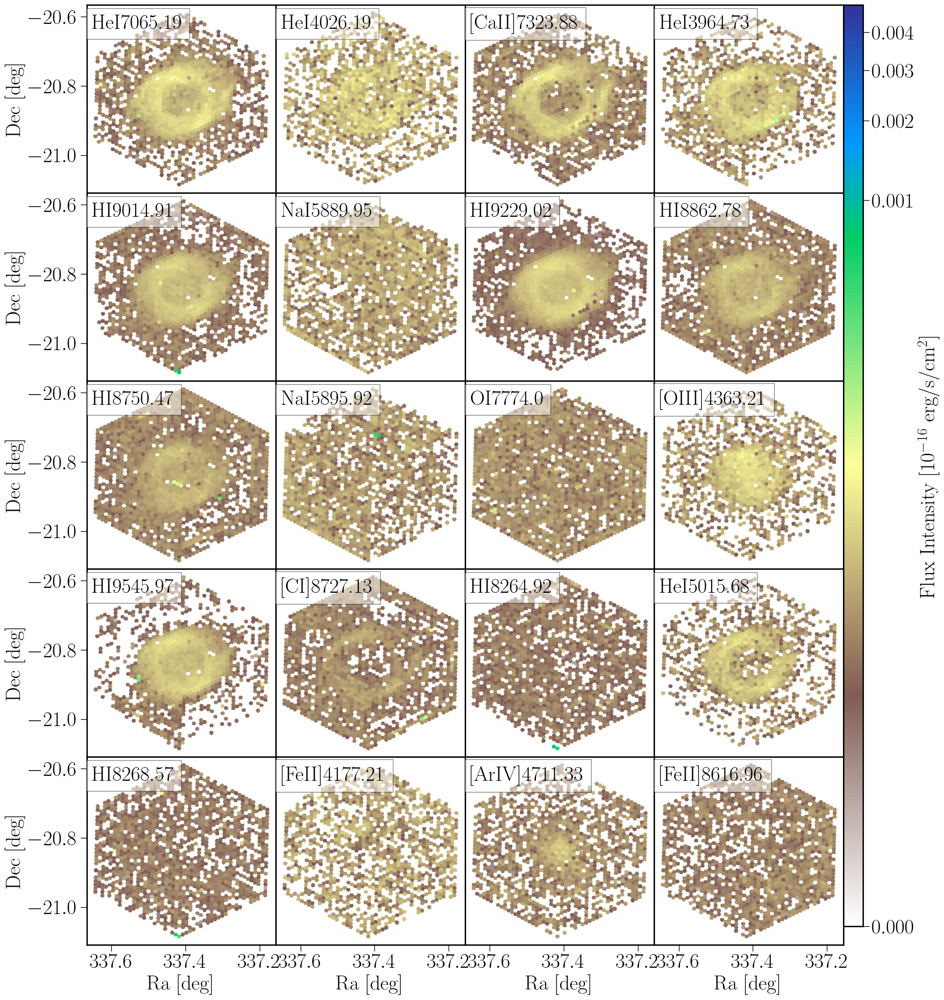

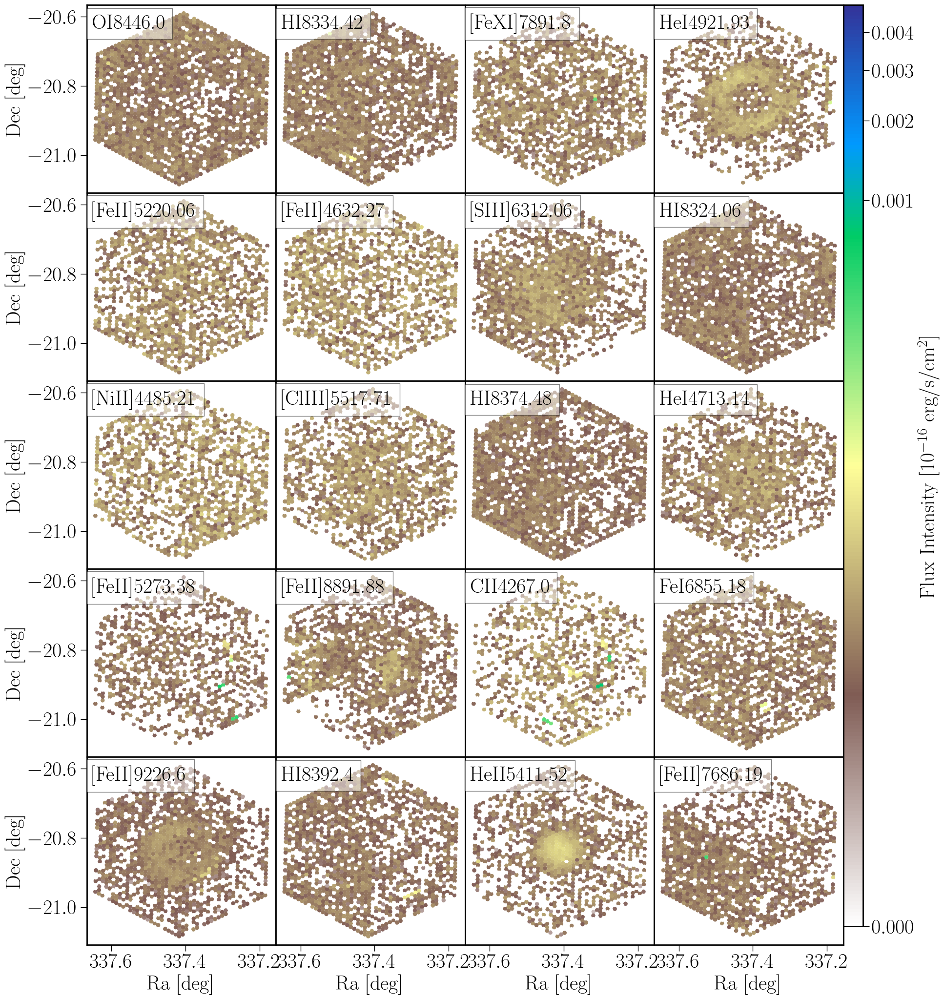

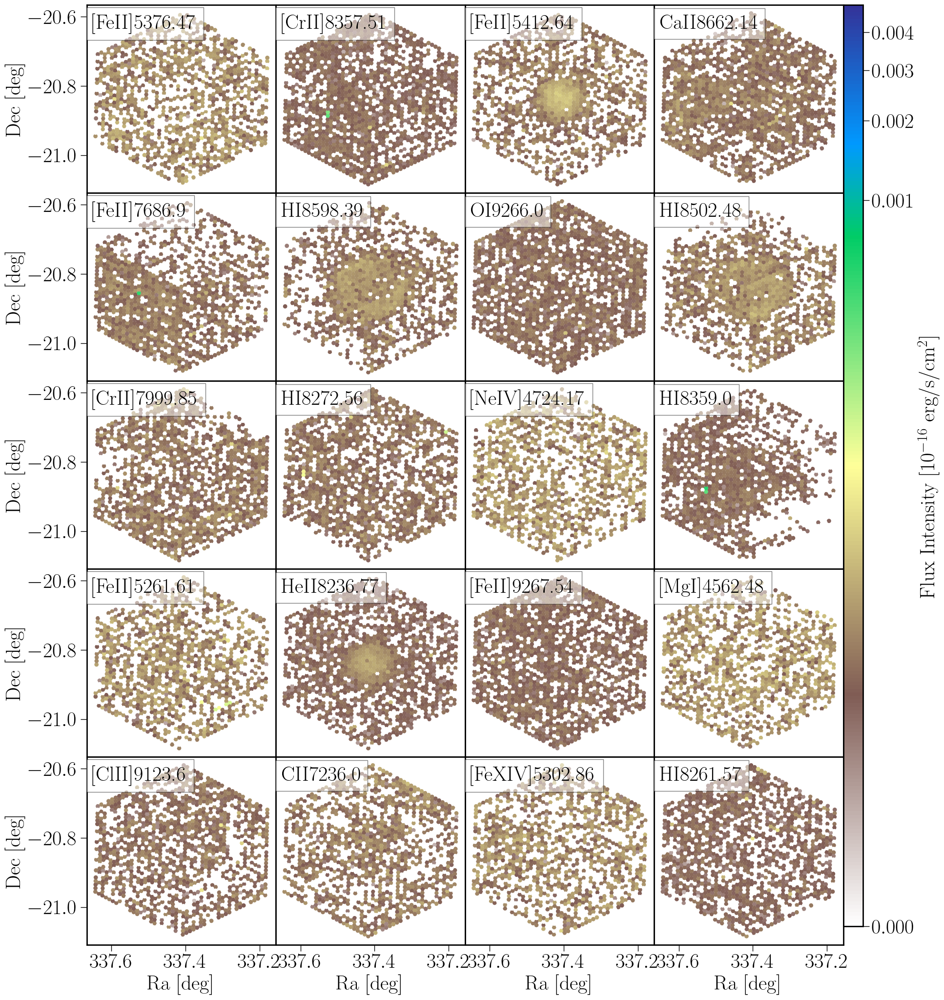

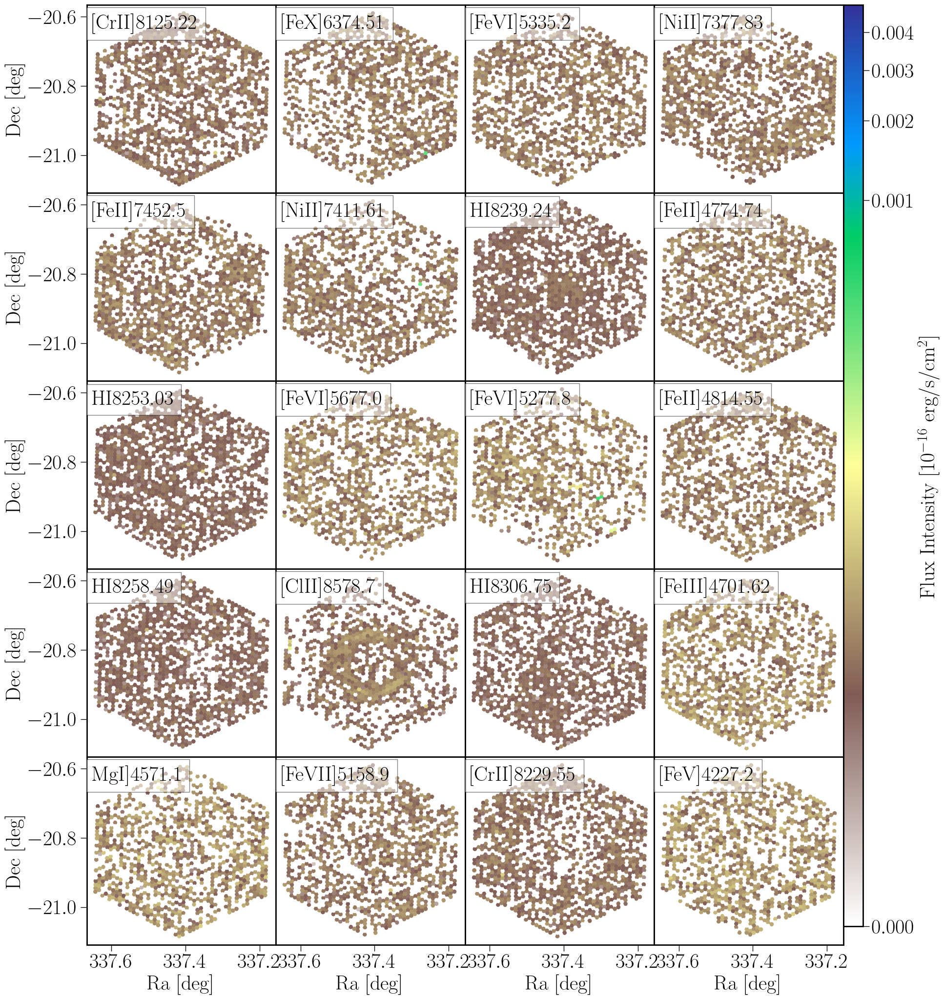

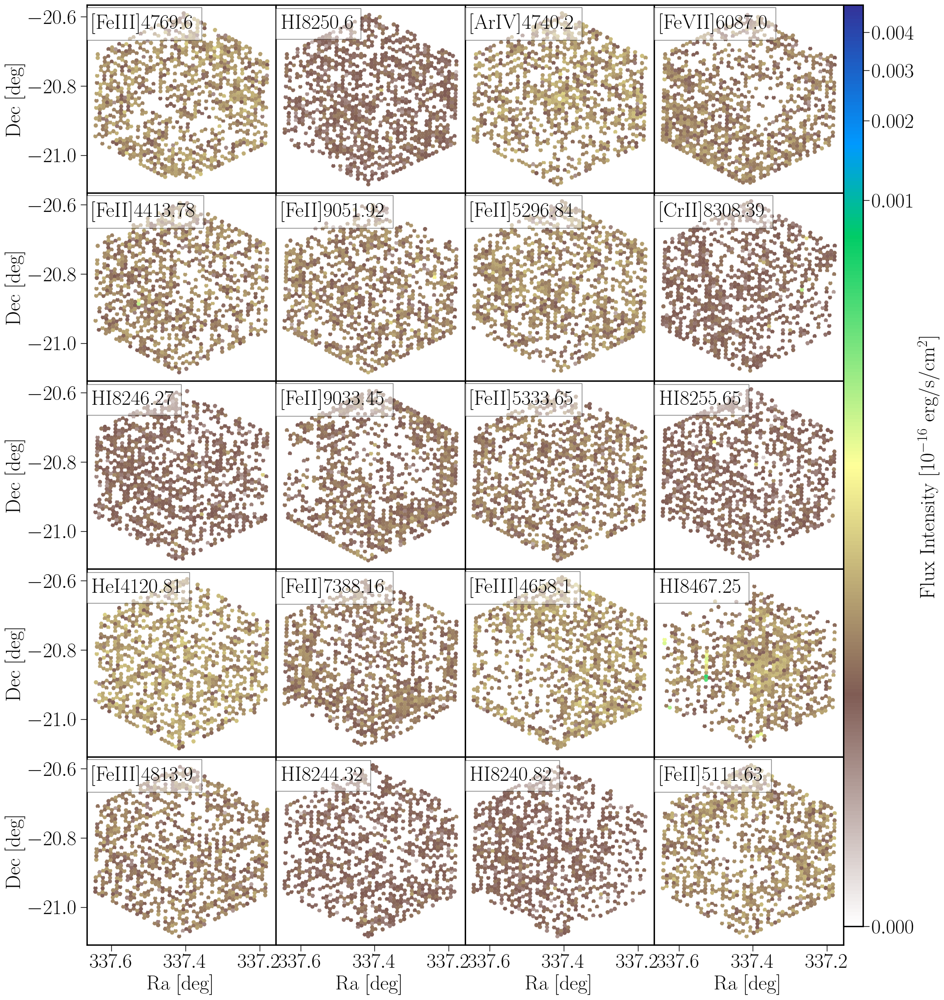

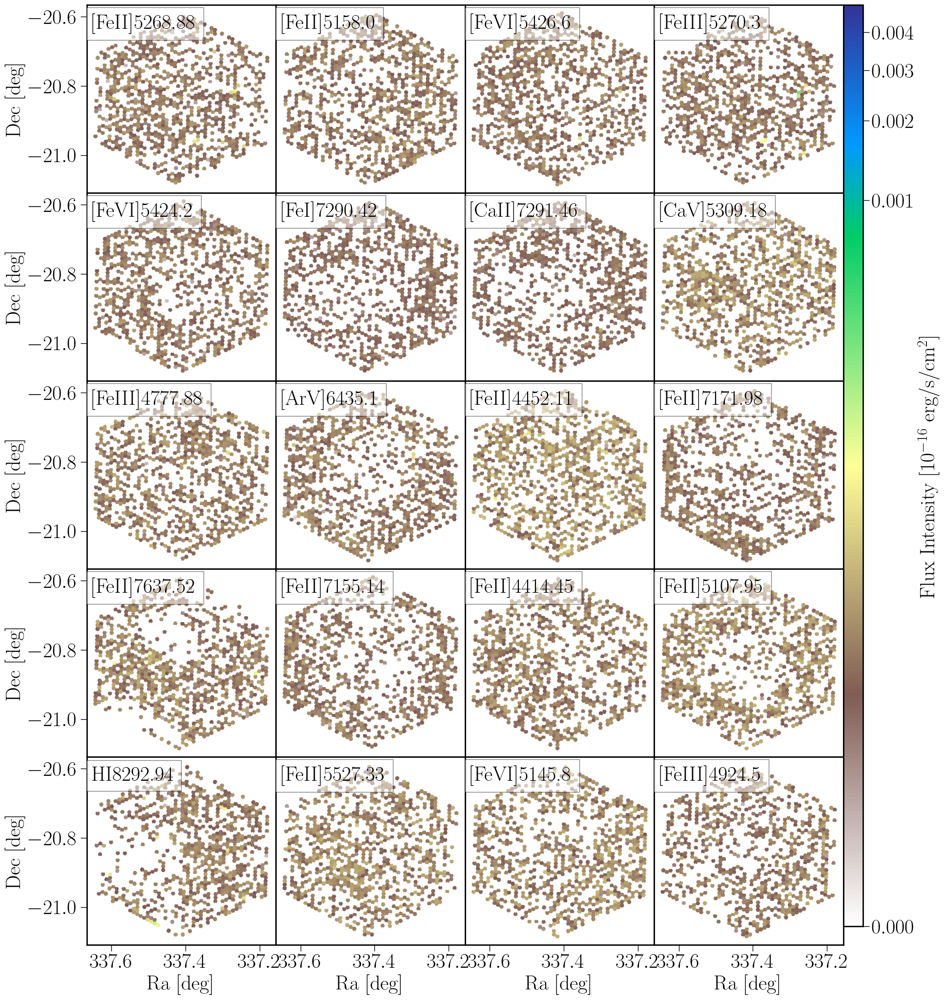

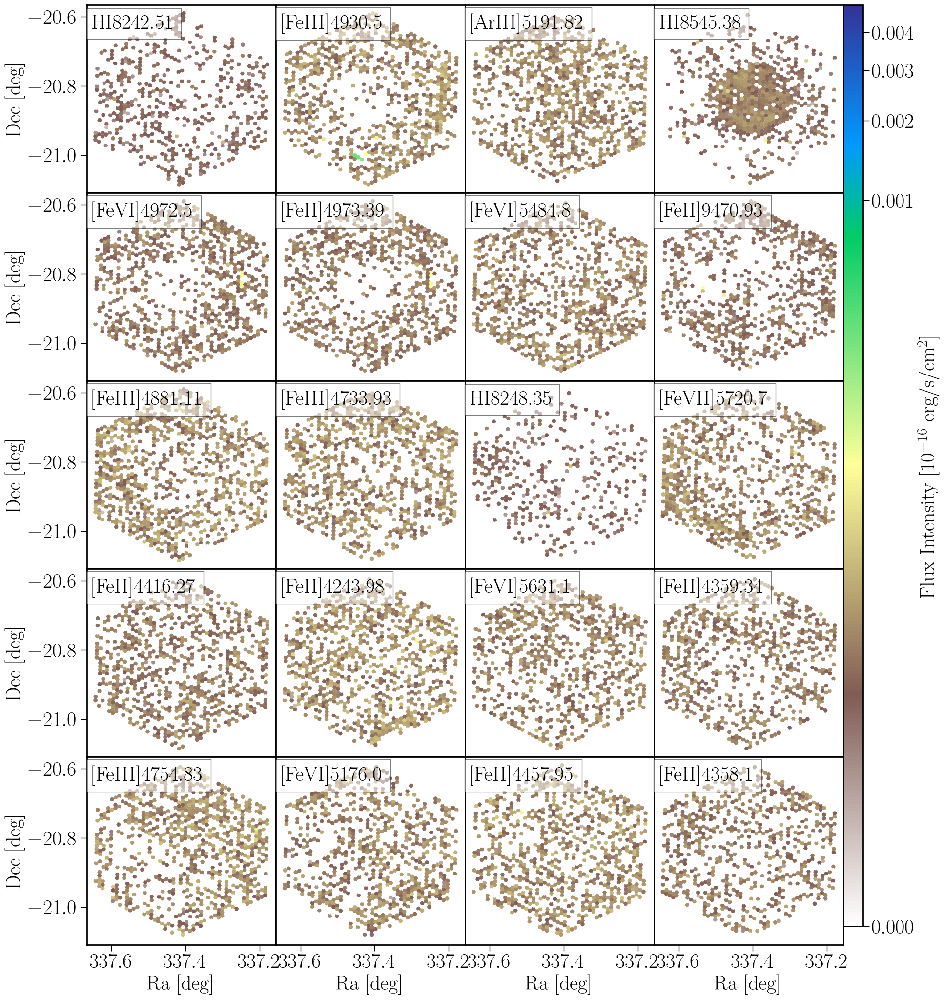

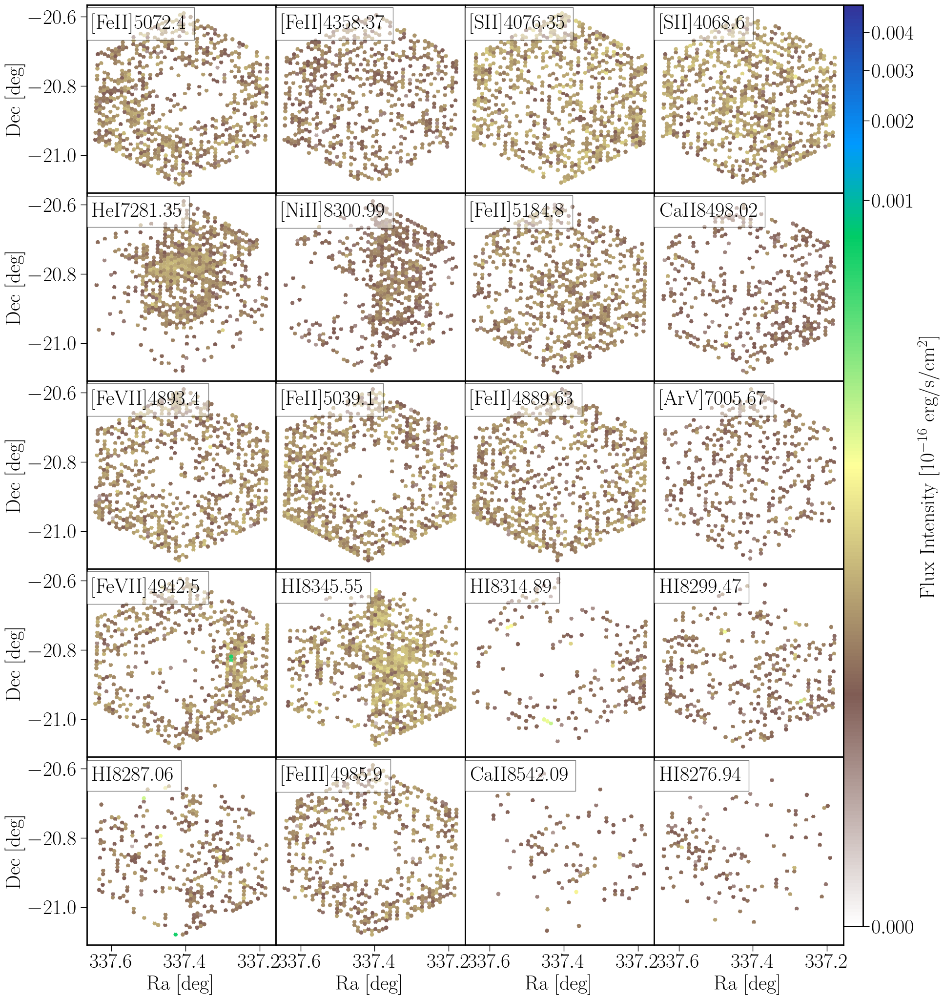

IndexError: index 215 out of range for table with length 215

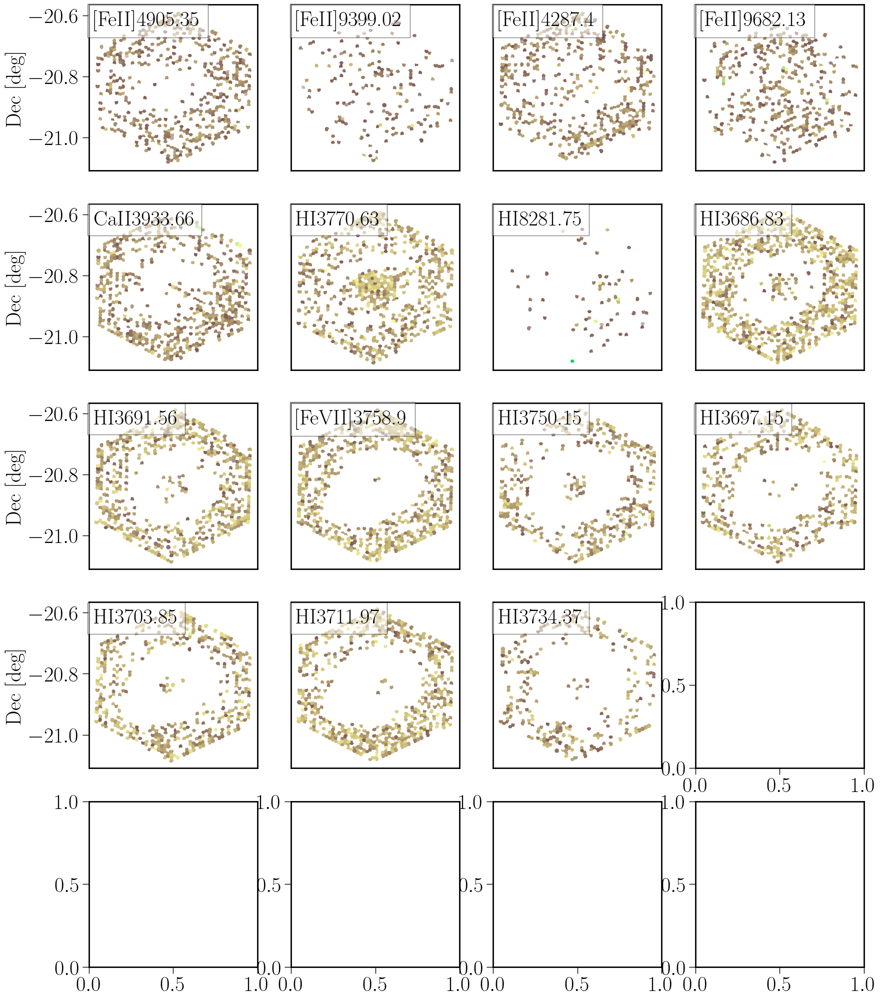

In [23]:
#cmap='gnuplot2_r'
#gamma=0.5
#cmap='pink_r'
#cmap='Spectral'
#cmap='nipy_spectral_r'
#cmap='cubehelix_r'
#cmap='terrain_r'
#fig = plt.figure()
NX=4
NY=5
I_now=0

for I0 in np.arange(0,len(tab_sum_flux),NX*NY):
    fig, axs = plt.subplots(nrows=NY, ncols=NX, figsize=(5*NX, 5*NY))#/1.3))


    #axs_flat = axs.flatten
    for I,ax in enumerate(np.ravel(axs)):
        #print(ax)
        tab_now=tab_sum_flux[I+I0]
        eline=tab_now['eline']
        wave=np.ceil(tab_now['wave'])
        II=str(I)
        if (I<10):
            II='0'+str(I)
        filename=f'Helix_{II}_{wave}'
        title=eline.replace('flux_','')
        title=title.replace('_','')
        title=title.replace('flux','')
        title=title.replace('alpha','$\\alpha$')
        title=title.replace('beta','$\\beta$')
        title=title.replace('gamma','$\\gamma$')    
        title=title.replace('delta','$\\delta$')
        title=title.replace('epsilon','$\\epsilon$')    
        xlab = False
        ylab = False
        if ((I/NX)==int(I/NX)):
            ylab=True
        else:
            ax.set_yticks([])
        if (I>=(NX*NY-4)):
            xlab=True
        else:
            ax.set_xticks([])
        vmin=0
        vmax=0.49e5
        
        scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                             vmin=0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
        
#        scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline,vmin=0, vmax=vmax, title=title, filename=filename, cmap=cmap, fsize=6.5,\
#                             figs_dir='figs',gamma=gamma,fig_type='pdf',xlab=xlab,ylab=ylab,sf=2.8)
        xx = ax.get_xlim()
        yy = ax.get_ylim()
        #print(xx,yy)
    cax = fig.add_axes([0.9, 0.125, 0.02, 0.755])     
#    cax = fig.add_axes([0.9, 0.11, 0.02, 0.77]) 
#    cax = fig.add_axes([0.9, 0.125, 0.02, 0.76])  # Ajusta estos valores según necesites
    cbar = fig.colorbar(scat, cax=cax, ax=axs.ravel().tolist(), orientation='vertical')#, format='%.0e')
    cbar.set_label('Flux Intensity [10$^{-16}$ erg/s/cm$^2$]')
    plt.subplots_adjust(wspace=0,hspace=0)
    plt.show()    
    #fig.tight_layout(w_pad=0.2)
    fig.savefig(f'figs/Helix_felines_{I_now}.pdf', facecolor='white')
    I_now=I_now+1

#if (I>3):
    #    break

In [ ]:
tab_DAP['flux_pe_6562.68']=tab_DAP['flux_pe_6562.85']
tab_DAP['e_flux_pe_6562.68']=tab_DAP['e_flux_pe_6562.85']


In [ ]:
#
# Write table Latex
#

tab_fe = Table.read('output_dap/m_sel-ORION.fe.ecsv')
n_cut=0

a_name=[]
a_flux=[]
a_e_flux=[]
for cols in tab_fe.colnames:
    if ((cols.find('flux_')>-1)&(cols.find('e_')==-1)):
        e_cols=f'e_{cols}'
#        print(cols,e_cols)
        title=cols.replace('flux_','')
        title=title.replace('_','')
        title=title.replace('flux','')
        title=title.replace('alpha','$\\alpha$')
        title=title.replace('beta','$\\beta$')
        title=title.replace('gamma','$\\gamma$')    
        title=title.replace('delta','$\\delta$')
        title=title.replace('epsilon','$\\epsilon$')   
        flux = tab_fe[cols].value[0]/1000
        e_flux = tab_fe[e_cols].value[0]/1000
        if (flux>5*e_flux):
#            print(f'{title} {flux} {e_flux}'
            a_name.append(title)
            a_flux.append(flux)
            a_e_flux.append(e_flux)
            n_cut=n_cut+1

a_name=np.array(a_name)
a_flux=np.array(a_flux)
a_e_flux=np.array(a_e_flux)
print(n_cut)
        
#mask_fe = (tab_fe.colnames == 'flux_') & (tab_fe.colnames = 'flux_')


In [ ]:
n_c=int(n_cut/3)
for I in range(n_c):
    print(' %s  & %5.2f  & %5.2f' % (a_name[I],a_flux[I],a_e_flux[I]),end='')
    print('& %s  & %5.2f  & %5.2f' % (a_name[I+n_c],a_flux[I+n_c],a_e_flux[I+n_c]),end='')
    print('& %s  & %5.2f  & %5.2f \\\\' % (a_name[I+2*n_c],a_flux[I+2*n_c],a_e_flux[I+2*n_c]))

    

In [ ]:
list_columns(tab_fe.colnames)

In [ ]:
n=len(tab_fe.colnames)
n_fe=int(n/8)
print(n/2/4,n_fe)

In [ ]:
for I in range(n_cut):
    if (a_name[I].find('beta')>-1):
#        print(' %s  & %5.2f  & %5.2f' % (a_name[I],a_flux[I],a_e_flux[I]))
        FHb = a_flux[I]
        e_FHb = a_e_flux[I]
        
for I in range(n_cut):
    if ((a_name[I].find('alpha')>-1) or (a_name[I].find('gamma')>-1) or (a_name[I].find('delta')>-1) or (a_name[I].find('epsilon')>-1) or (a_name[I].find('HI')>-1)):
#        print(' %s  & %5.2f  & %5.2f' % (a_name[I],a_flux[I],a_e_flux[I]))
        rat = a_flux[I]/FHb
        e_rat = a_e_flux[I]/FHb+e_FHb*rat/FHb
        print(' %s/H$\\beta$  & %5.2f $\pm$ %5.2f' % (a_name[I],rat,e_rat))
        
        